In [2]:
# Importing packages
import sys
import numpy as np
import pandas as pd
# Packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import sys
#!{sys.executable} -m pip install folium
import folium
from urllib.request import urlopen
import json
import os
#!{sys.executable} -m pip install geopandas
import plotly.express as px
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import seaborn as sns
import matplotlib.pyplot as plt
!{sys.executable} -m pip install colorcet
import colorcet as cc


# Loading our data sets
health = pd.read_csv("../Datasets/rankmd.csv", delimiter=";")
FastFood = pd.read_csv("../Datasets/FastFoodRestaurants.csv")
income = pd.read_csv("../Datasets/kaggle_income.csv", encoding="ISO 8859-1")
mixed = pd.read_csv("../Datasets/Mixed_data.csv", encoding="ISO 8859-1")

us_state_to_abbrev = {
    "Alabama": "AL",
    "Alaska": "AK",
    "Arizona": "AZ",
    "Arkansas": "AR",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Hawaii": "HI",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Iowa": "IA",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Maine": "ME",
    "Maryland": "MD",
    "Massachusetts": "MA",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Mississippi": "MS",
    "Missouri": "MO",
    "Montana": "MT",
    "Nebraska": "NE",
    "Nevada": "NV",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "New York": "NY",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Vermont": "VT",
    "Virginia": "VA",
    "Washington": "WA",
    "West Virginia": "WV",
    "Wisconsin": "WI",
    "Wyoming": "WY",
    "District of Columbia": "DC",
    "American Samoa": "AS",
    "Guam": "GU",
    "Northern Mariana Islands": "MP",
    "Puerto Rico": "PR",
    "United States Minor Outlying Islands": "UM",
    "U.S. Virgin Islands": "VI",
}
# Avoid misrepresented outputs
import warnings
warnings.filterwarnings('ignore')
    
# invert the dictionary
abbrev_to_us_state = dict(map(reversed, us_state_to_abbrev.items()))

FastFood['State'] = FastFood['province'].map(abbrev_to_us_state)
States = health.copy()
# Zero padding the FIPS code, as pandas don't accept leading 0's. 
States = States[States['FIPS'].astype(str).str.endswith('000')]
health['FIPS']=health['FIPS'].apply(lambda x: '{0:0>5}'.format(x))
health["food_environment_index_Food Environment Index"] = health["food_environment_index_Food Environment Index"].str.replace(",",".").astype(float)

## Creating the statewise plot of health data

As we have alot of states we will start by plotting the contributers to loss of death prematurely, how many years of life that is lost based on premature death. 
The number of Fastfood restaurants per state and the percentage of obesity per state. 

We do this as our goal is to explore public health and well being, based on fastfood restaurants, and obesity is one major factor contributing to the loss of life prematurely. 
Likewise fastfood can lead to obesity. 

A simlpe bar plot can give us indications of how different states are ranked; likewise each state has a specific color so it is easier to navigate throughout the four plots as they can seem quite overwhelming.  

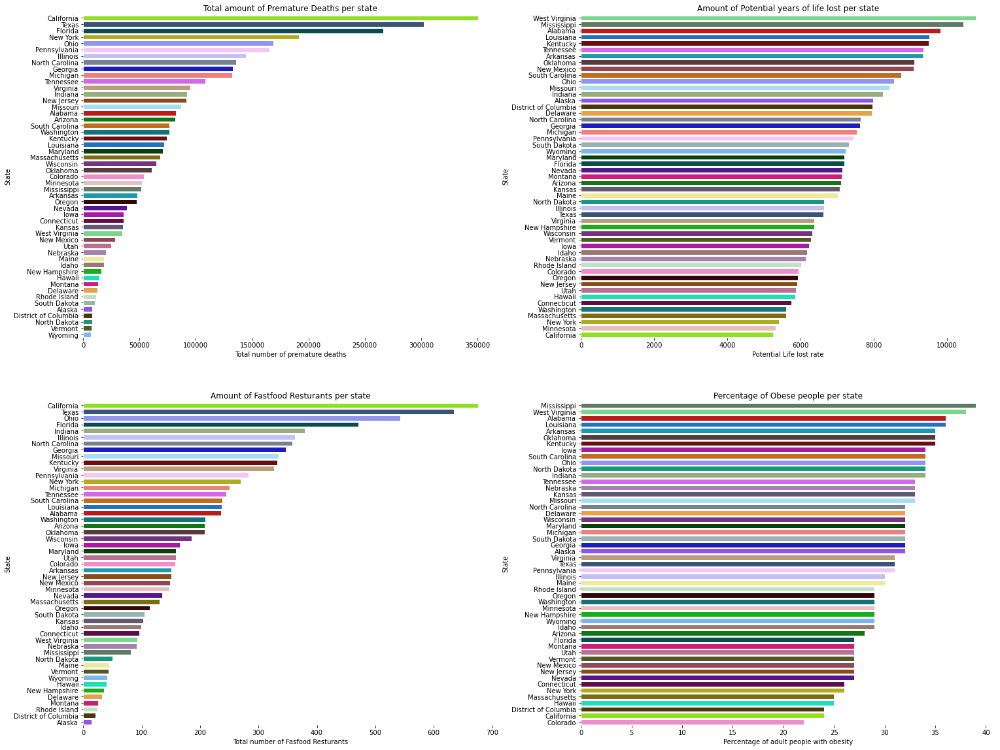

In [3]:
#Define subplots to be a 2x2 grid
fig, axes = plt.subplots(2, 2, sharex=False, figsize=(25,20))
sns.set(rc={'figure.figsize':(12,9)})
sns.despine(left=True, bottom=True)
sns.set_color_codes("muted")

s = States['State'].unique()

palette = sns.color_palette(cc.glasbey, 51)

hue_dic = dict(zip(s, palette))
# Bar plot of prepamature deaths per state
sns.barplot(ax=axes[0,0], data=States.sort_values("premature_deathDeaths",ascending=False), y='State', x='premature_deathDeaths', palette=hue_dic).set(title='Total amount of Premature Deaths per state',  xlabel='Total number of premature deaths')
# Years of potential life lost per state
sns.barplot(ax=axes[0,1], data=States.sort_values("premature_deathYears_of_Potential_Life_Lost_Rate",ascending=False), y='State', x='premature_deathYears_of_Potential_Life_Lost_Rate', palette=hue_dic).set(title='Amount of Potential years of life lost per state',  xlabel='Potential Life lost rate')
# Number of fastfood restaurants per state
sns.barplot(ax=axes[1,0], data=FastFood.groupby(['State']).count().reset_index().sort_values("address",ascending=False), y='State', x='address', palette=hue_dic).set(title='Amount of Fastfood Resturants per state', xlabel='Total number of Fasfood Resturants')
# Percentage of obesity per state 
sns.barplot(ax=axes[1,1], data=States.sort_values('adult_obesity_% Adults with Obesity',ascending=False), y='State', x='adult_obesity_% Adults with Obesity', palette=hue_dic).set(title='Percentage of Obese people per state', xlabel='Percentage of adult people with obesity')

# Save subplot for website hosting as png file
fig.savefig("../Visulisations/4x4plot.png") 

# Fastfood restaurants 

We plot the *"popularity"* of the fastfood restaurants, to find our top 10. This will be our focus point. 
We did already see the plot with many colors, and to ease it up a bit for future use we decided to color each of the top 10 restaurants in the own destinctive color.
As the top 10 accounts for the "major" contribution of restaurants across the US.  

In [4]:
colorindex=(FastFood["Chain"]=="mcdonalds")+(FastFood["Chain"]=="burger king")*2+(FastFood["Chain"]=="taco bell")*3+(FastFood["Chain"]=="wendys")*4+(FastFood["Chain"]=="arbys")*5+(FastFood["Chain"]=="kfc")*6+(FastFood["Chain"]=="subway")*7+(FastFood["Chain"]=="sonic drive in")*8+(FastFood["Chain"]=="dominos pizza")*9

# Colors for the fastfood restaurants 
# Yellow Mcdonalds, Orange for Burger King, Purple for Taco bell, Red for Wendys, Green for Arbys, KFC Beige, Dark green Subway, Blue for Sonic, Dark blue for Domino's, Dark grey for Other
restaurants=['Other',"Mcdonald's", 'Burger King', 'Taco Bell', "Wendy's", "Arby's", 'KFC', 'Subway', 'Sonic drive-in', "Domino's Pizza"]
colors=["#4A4A4A","#FFFF00", "#FF6103", "#8A2BE2","#FF3030", "#00C957", "#FFE4C4", "#228B22", "#1E90FF", "#104E8B"]

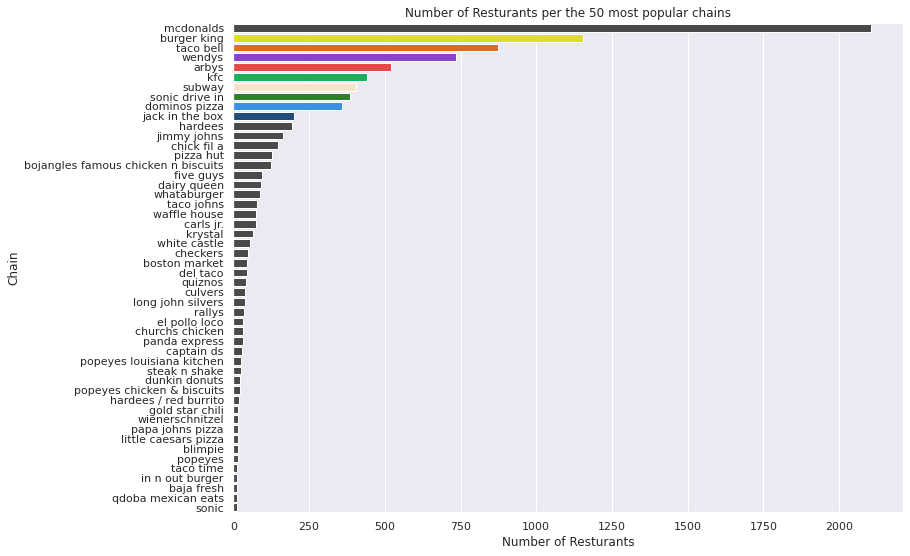

In [5]:
# Create a color index for the top 10 colors 
colorindex=(FastFood["Chain"]=="mcdonalds")+(FastFood["Chain"]=="burger king")*2+(FastFood["Chain"]=="taco bell")*3+(FastFood["Chain"]=="wendys")*4+(FastFood["Chain"]=="arbys")*5+(FastFood["Chain"]=="kfc")*6+(FastFood["Chain"]=="subway")*7+(FastFood["Chain"]=="sonic drive in")*8+(FastFood["Chain"]=="dominos pizza")*9


# Appending the dark color for each of the other chains that are in the 'Other' group
for i in range(len(FastFood["Chain"].unique())-9):
    colors.append("#4A4A4A")

# Bar plot
FastFood["Chain"] = FastFood["name"].str.lower().str.replace(r"[\"\',]", '').str.replace(r"\-"," ")
sns.barplot(data=FastFood.groupby(['Chain']).count().reset_index().sort_values('address',ascending=False)[0:50], y='Chain', x='address', palette=colors).set(title='Number of Resturants per the 50 most popular chains', xlabel='Number of Resturants')
plt.savefig('../docs/exploring_the_data/stat2.png')



With the knowledge of the major contributers for restaurants across the US, it was time to create a location of map, to see how they might accumulate throughout the country. We expect that a vast majority of the restaurants will be around the major cities. 
For this a Folium map, with the colors decided previously for the 10 major restaurants and `other` fits nicely.

In [33]:
# Coordinates for USA
lat, lon = 37.77919, -100.41914 

# Lists of coordinates for fastfood restaurants
lat_list = list(FastFood.latitude)
lon_list = list(FastFood.longitude)

# Creating map and point layers
map_FF = folium.Map([lat, lon], tiles = "Stamen Toner", zoom_start=4)
point_layer = [folium.FeatureGroup(name=restaurants[0]), folium.FeatureGroup(name=restaurants[1]), folium.FeatureGroup(name=restaurants[2]), folium.FeatureGroup(name=restaurants[3]), folium.FeatureGroup(name=restaurants[4]), folium.FeatureGroup(name=restaurants[5]), folium.FeatureGroup(name=restaurants[6]), folium.FeatureGroup(name=restaurants[7]), folium.FeatureGroup(name=restaurants[8]), folium.FeatureGroup(name=restaurants[9])]

# Creating the points to the map in the respective layer
for i in range(len(FastFood)):
    point_layer[colorindex[i]].add_child(folium.Circle(location=[lat_list[i], lon_list[i]], radius=50,
    color=colors[colorindex[i]],
    fill=True,
    # Adding HTML styling for more detail to the pop up.
    popup=folium.Popup(f"""<b>Name: </b>  {restaurants[colorindex[i]]} <br>
                               <b>Address: </b>  {FastFood["address"][i]} <br>
                               <b>State: </b>  {FastFood["State"][i]} <br>
                               <b>County: </b> {FastFood["County"][i]}
                            """, max_width=len(f"name= {restaurants[colorindex[i]]}")*20),
    fill_color="#3186cc", tooltip = restaurants[colorindex[i]])).add_to(map_FF)
    
# Adding the point layers to the map
map_FF.add_child(point_layer[0])
map_FF.add_child(point_layer[1])
map_FF.add_child(point_layer[2])
map_FF.add_child(point_layer[3])
map_FF.add_child(point_layer[4])
map_FF.add_child(point_layer[5])
map_FF.add_child(folium.LayerControl())     

# Showing the map
map_FF.save("Fastfood_locations.html") # Save map as HTML for hosting on other GitHub Repo
map_FF


To our Surprise a vast majority of the restaurants were located on the east side of the country. We expected a more even distribution. 
However after realising that 36% of the United States' population is housed on the east side **[[14]](https://worldpopulationreview.com/state-rankings/east-coast-states)** it made alot more sense that the accumulated restaurants would be placed there. 


Looking at the West Coast distribution we see a pattern of accumulated restaurants around the big cities like Washington, Los Angeles and in Nevada Las Vegas. 

# Exploring the Food Enviroment Index score per state


With knowledge of how the states performed health wise and county wise, and knowing of where the FastFood restaurants are located, we explored the `Food Envirometn Index Scoring`. 
This tells something about; the salery in that area vs possibilty to buy healthy food, and grocery store distribution. 

The goal was to find some sort of correlation between a bad food enviroment index and perhabs the ease of access to fastfood as a quick and cheap alternative; compared driving further to a grocery store. 

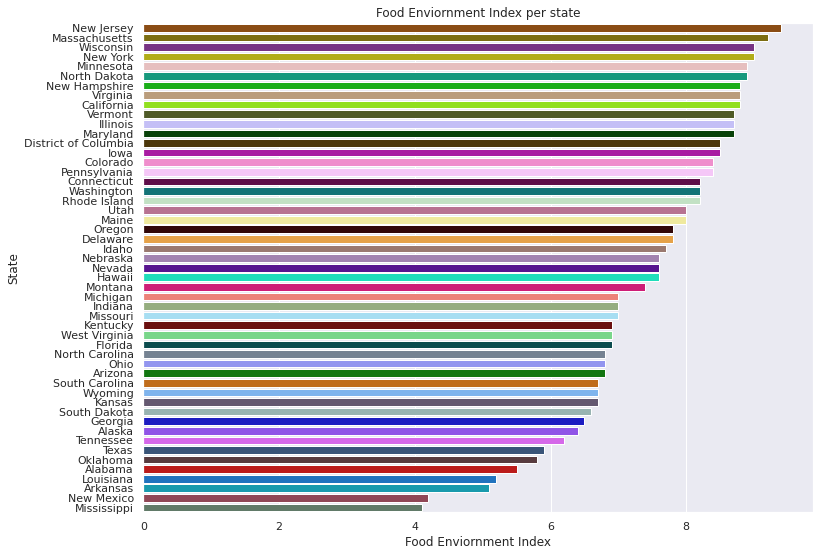

In [6]:
# Correct the data format
States["food_environment_index_Food Environment Index"] = States["food_environment_index_Food Environment Index"].str.replace(",",".").astype(float)
# Create a barplot in decreasing order of the state and the corresponding food enviroment index score
sns.barplot(data=States.sort_values("food_environment_index_Food Environment Index",ascending=False), y='State', x='food_environment_index_Food Environment Index', palette=hue_dic).set(title='Food Enviornment Index per state',  xlabel='Food Enviornment Index')
# Save the plot for GitHub Repository hosting
plt.savefig('../Visulisations/FoodEnv.png', dpi=300)

New Jersy came out on top, and California which previously in account of percentage of obesied people were 2nd lowest and had the most fastfood chains was also in the top range of the scoring. 

To explore county wise; we created a *Choropleth - map*, this would make it easier for us to explore the counties and areas by having a heatmap overview, but also for the reader to themselves explore

## Checking County wise food enviroment index scores

In [35]:
# Create Plotly Chropleth map
fig = px.choropleth_mapbox(health, geojson=counties, locations='FIPS', color="food_environment_index_Food Environment Index",
                           color_continuous_scale="Viridis",
                           range_color=(0, 10),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.77919, "lon": -100.41914},
                           opacity=0.5,
                           labels={'food_environment_index_Food Environment Index':'Food Enviornement Index'},
                           hover_data=["State", "County"] # Add additional info to mouse-overs (Hovers) 
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Save the plot as HTML, for hosting on the GitHub Repository website. 
fig.write_html("foodindx.html")

# Obesity percentage

In [38]:
# Create Plotly Choropleth map with the Obesity percentage countyswise. 
fig = px.choropleth_mapbox(health.fillna(0), geojson=counties, locations='FIPS', color='adult_obesity_% Adults with Obesity',
                           color_continuous_scale="Viridis",
                           range_color=(0, max(health['adult_obesity_% Adults with Obesity'])),
                           mapbox_style="carto-positron",
                           zoom=3.3, center = {"lat": 37.77919, "lon": -100.41914},
                           opacity=0.5,
                           labels={'adult_obesity_% Adults with Obesity':'Adult obesity percentage'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Save as HTML for GitHub  Repository hosting
fig.write_html("obesitypercentage.html")

This plot shows the obesity percentage, which are overall a somewhat bright green however with the west part seeming more purple in comparison to the east part, which seems more yellow. 